Stable Diffusion for image interpolation creates smooth transitions between two images using a diffusion-based generative model. Key use cases include:

1. **Data Augmentation**: Generating synthetic images to enhance machine learning model training, improving generalization and robustness for tasks like image generation, classification, and object detection.
2. **Product Design and Prototyping**: Exploring design alternatives by generating variations of product designs or prototypes.
3. **Media Production**: Creating intermediate frames between key frames in video editing to produce smoother transitions.

Stable Diffusion navigates a high-dimensional latent space, using prompt and image latents to generate a sequence of intermediate images by interpolating between different latent representations. Latent space walking allows control over features like style and content by selecting points in this space.


In [1]:
!pip install -q diffusers transformers xformers accelerate
!pip install -q numpy scipy ftfy Pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 34.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.7/16.7 MB 63.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.9 MB/s eta 0:00:00


In [3]:
import torch
import numpy as np
import os

import time

from PIL import Image
from IPython import display as IPdisplay
from tqdm.auto import tqdm

from diffusers import StableDiffusionPipeline
from diffusers import (
    DDIMScheduler,
    PNDMScheduler,
    LMSDiscreteScheduler,
    DPMSolverMultistepScheduler,
    EulerAncestralDiscreteScheduler,
    EulerDiscreteScheduler,
)
from transformers import logging

logging.set_verbosity_error()
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

These settings are used to optimize the performance of PyTorch models on CUDA-enabled GPUs, especially when using mixed precision training or inference, which can be beneficial in terms of speed and memory usage.
Source: https://huggingface.co/docs/diffusers/optimization/fp16#memory-efficient-attention



In [4]:
torch.backends.cudnn.benchmark = True
torch.backends.cuda.matmul.allow_tf32 = True

The runwayml/stable-diffusion-v1-5 model and the LMSDiscreteScheduler scheduler were chosen to generate images. Despite being an older technology, it continues to enjoy popularity due to its fast performance, minimal memory requirements, and the availability of numerous community fine-tuned models built on top of SD1.5.

In [5]:
model_name_or_path = "runwayml/stable-diffusion-v1-5"

scheduler = LMSDiscreteScheduler(
    beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000
)

pipe = StableDiffusionPipeline.from_pretrained(
    model_name_or_path,
    scheduler=scheduler,
    torch_dtype=torch.float32,
).to(device)

# Disable image generation progress bar, we'll display our own
pipe.set_progress_bar_config(disable=True)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:201: FutureWarning: The configuration file of this scheduler: LMSDiscreteScheduler {
  "_class_name": "LMSDiscreteScheduler",
  "_diffusers_version": "0.30.3",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "steps_offset": 0,
  "timestep_spacing": "linspace",
  "trained_betas": null,
  "use_karras_sigmas": false
}
 is outdated. `steps_offset` should be set to 1 instead of 0. Please make sure to update

These methods are designed to reduce the memory consumed by the GPU. If you have enough VRAM, you can skip this cell.

More detailed information can be found here: https://huggingface.co/docs/diffusers/en/optimization/opt_overview
In particular, information about the following methods can be found here: https://huggingface.co/docs/diffusers/optimization/memory

In [6]:
# Offloading the weights to the CPU and only loading them on the GPU can reduce memory consumption to less than 3GB.
pipe.enable_model_cpu_offload()

# Tighter ordering of memory tensors.
pipe.unet.to(memory_format=torch.channels_last)

# Decoding large batches of images with limited VRAM or batches with 32 images or more by decoding the batches of latents one image at a time.
pipe.enable_vae_slicing()

# Splitting the image into overlapping tiles, decoding the tiles, and then blending the outputs together to compose the final image.
pipe.enable_vae_tiling()

# Using Flash Attention; If you have PyTorch >= 2.0 installed, you should not expect a speed-up for inference when enabling xformers.
pipe.enable_xformers_memory_efficient_attention()

In [7]:
def display_images(images, save_path):
  try:
      # images list to Image object
      images = [Image.fromarray(np.array(image[0], dtype=np.uint8)) for image in images]

      filename = time.strftime("%H:%M:%S", time.localtime()).replace(":", "-")

      # save  first image as a GIF file at save_path
      # rest images added as subsequent frames to the GIF
      # GIF will play each frame for 100 milliseconds and will loop indefinitely
      images[0].save(
            f"{save_path}/{filename}.gif",
            save_all=True,
            append_images=images[1:],
            duration=100,
            loop=0,
        )
  except Exception as e:
      print(e)

  return IPdisplay.Image(f"{save_path}/{filename}.gif")

Generation parameters

- seed: This variable is used to set a specific random seed for reproducibility.
- generator: This is set to a PyTorch random number generator object if a seed is provided, otherwise it is None. It ensures that the operations using it have reproducible outcomes.
- guidance_scale: This parameter controls the extent to which the model should follow the prompt in text-to-image generation tasks, with higher values leading to stronger adherence to the prompt.
- num_inference_steps: This specifies the number of steps the model takes to generate an image. More steps can lead to a higher quality image but take longer to generate.
- num_interpolation_steps: This determines the number of steps used when interpolating between two points in the latent space, affecting the smoothness of transitions in generated animations.
- height: The height of the generated images in pixels.
- width: The width of the generated images in pixels.
- save_path: The file system path where the generated gifs will be saved.

In [8]:
# None bc we want different results each time we run the generation
seed = None
if seed is not None:
    generator = torch.manual_seed(seed)
else:
    generator = None

# The guidance scale normal range (7 - 10).
guidance_scale = 8

# chosen empirically to generate acceptable picture within an acceptable time
num_inference_steps = 15

# the higher, the smoother the interpolations.
# however, the generation time will increase. This value was chosen empirically.
num_interpolation_steps = 30

# not recommended less than 512 on each dim. bc model was trained on 512x512 image resolution
height = 512
width = 512

save_path = "/output"

if not os.path.exists(save_path):
    os.makedirs(save_path)

## prompt interpolation

In [9]:
prompt = "Epic shot of Sweden, ultra detailed lake with an ren dear, nostalgic vintage, ultra cozy and inviting, wonderful light atmosphere, fairy, little photorealistic, digital painting, sharp focus, ultra cozy and inviting, wish to be there. very detailed, arty, should rank high on youtube for a dream trip."
negative_prompt = "poorly drawn,cartoon, 2d, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry"

step_size = 0.001

prompt_tokens = pipe.tokenizer(
    prompt,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
prompt_embeds = pipe.text_encoder(prompt_tokens.input_ids.to(device))[0]


if negative_prompt is None:
    negative_prompt = [""]
negative_prompt_tokens = pipe.tokenizer(
    negative_prompt,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
negative_prompt_embeds = pipe.text_encoder(negative_prompt_tokens.input_ids.to(device))[0]

In [15]:
print(pipe.unet.config.in_channels)

# generate initial latent vectors from a random normal distribution
# with the option to use a generator for reproducibility
latents = torch.randn(
    (1, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)
print(latents.shape)

walked_embeddings = []

# Interpolating between embeddings for the given number of interpolation steps.
for i in range(num_interpolation_steps):
    walked_embeddings.append([prompt_embeds + step_size * i, negative_prompt_embeds + step_size * i])

print(walked_embeddings)

4
torch.Size([1, 4, 64, 64])
[[tensor([[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
         [-2.0327, -0.1290,  2.4146,  ..., -0.1717,  0.8631,  0.3084],
         [-0.7558,  0.8695,  0.7272,  ..., -0.8368,  0.0311,  1.3596],
         ...,
         [ 2.0546, -1.1966, -1.0902,  ...,  0.0965, -1.7690, -2.0818],
         [ 2.0744, -1.1956, -1.0859,  ...,  0.0767, -1.7603, -2.0800],
         [ 1.9598, -1.2962, -1.2214,  ...,  0.0613, -1.5340, -2.1145]]],
       device='cuda:0', grad_fn=<AddBackward0>), tensor([[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
         [ 1.8395, -1.5509,  0.1385,  ..., -0.9210,  2.0371,  0.0906],
         [ 0.2129,  0.4523,  1.1048,  ..., -0.4702, -0.3314,  1.1507],
         ...,
         [-0.0463,  0.2278, -1.1540,  ..., -2.6150, -0.0714, -1.4551],
         [-0.0776,  0.2545, -1.1564,  ..., -2.6155, -0.0755, -1.4564],
         [-0.0597,  0.3157, -1.2772,  ..., -2.5386, -0.0920, -1.4638]]],
       device='cuda:0', grad_fn=<Add

  0%|          | 0/30 [00:00<?, ?it/s]

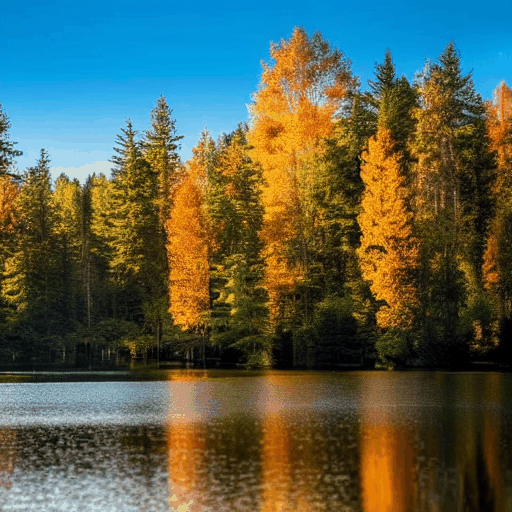

In [16]:
# generate imgs using interpolated embs
images = []
for latent in tqdm(walked_embeddings):
    images.append(
        pipe(
            height=height,
            width=width,
            num_images_per_prompt=1,
            prompt_embeds=latent[0],
            negative_prompt_embeds=latent[1],
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latents,
        ).images
    )

display_images(images, save_path)

## diffusion latents interpolation single prompt

Unlike the first example, in this one, we are performing interpolation between the two embeddings of the diffusion model itself, not the prompts. Please note that in this case, we use the slerp function for interpolation.

The source is from Andrej Karpathy’s gist: https://gist.github.com/karpathy/00103b0037c5aaea32fe1da1af553355.
A more detailed explanation of this method can be found at: https://en.wikipedia.org/wiki/Slerp.

In [17]:
def slerp(v0, v1, num, t0=0, t1=1):
    v0 = v0.detach().cpu().numpy()
    v1 = v1.detach().cpu().numpy()

    def interpolation(t, v0, v1, DOT_THRESHOLD=0.9995):
        """helper function to spherically interpolate two arrays v1 v2"""
        dot = np.sum(v0 * v1 / (np.linalg.norm(v0) * np.linalg.norm(v1)))
        if np.abs(dot) > DOT_THRESHOLD:
            v2 = (1 - t) * v0 + t * v1
        else:
            theta_0 = np.arccos(dot)
            sin_theta_0 = np.sin(theta_0)
            theta_t = theta_0 * t
            sin_theta_t = np.sin(theta_t)
            s0 = np.sin(theta_0 - theta_t) / sin_theta_0
            s1 = sin_theta_t / sin_theta_0
            v2 = s0 * v0 + s1 * v1
        return v2

    t = np.linspace(t0, t1, num)

    v3 = torch.tensor(np.array([interpolation(t[i], v0, v1) for i in range(num)]))

    return v3

  0%|          | 0/30 [00:00<?, ?it/s]

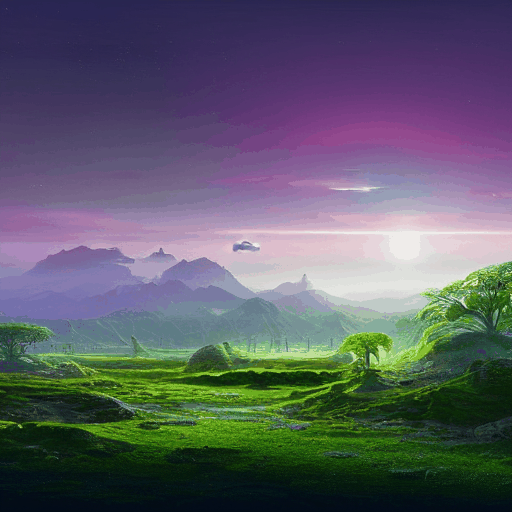

In [18]:
prompt = (
    "Sci-fi digital painting of an alien landscape with otherworldly plants, strange creatures, and distant planets."
)
negative_prompt = "poorly drawn,cartoon, 3d, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry"

# generate initial latent vectors from random normal distribution.
# wo latent vectors are generated which will serve as start and end points for the interpolation
# These are shaped to fit input requirements of the diffusion model's U-Net
latents = torch.randn(
    (2, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)

# get latent embeddings
interpolated_latents = slerp(latents[0], latents[1], num_interpolation_steps)

# generate imgs using interpolated embeddings
images = []
for latent_vector in tqdm(interpolated_latents):
    images.append(
        pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latent_vector[None, ...],
        ).images
    )

# Display of saved generated images.
display_images(images, save_path)

## interpolation between multiple prompts

In [19]:
prompts = [
    "A cute dog in a beautiful field of lavander colorful flowers everywhere, perfect lighting, leica summicron 35mm f2.0, kodak portra 400, film grain",
    "A cute cat in a beautiful field of lavander colorful flowers everywhere, perfect lighting, leica summicron 35mm f2.0, kodak portra 400, film grain",
]
negative_prompts = [
    "poorly drawn,cartoon, 2d, sketch, cartoon, drawing, anime, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry",
    "poorly drawn,cartoon, 2d, sketch, cartoon, drawing, anime, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry",
]

batch_size = len(prompts)

prompts_tokens = pipe.tokenizer(
    prompts,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
prompts_embeds = pipe.text_encoder(prompts_tokens.input_ids.to(device))[0]

if negative_prompts is None:
    negative_prompts = [""] * batch_size
negative_prompts_tokens = pipe.tokenizer(
    negative_prompts,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
negative_prompts_embeds = pipe.text_encoder(negative_prompts_tokens.input_ids.to(device))[0]

In [20]:
latents = torch.randn(
    (1, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)

# interpolating between embeddings pairs for  given number of interpolation steps
interpolated_prompt_embeds = []
interpolated_negative_prompts_embeds = []
for i in range(batch_size - 1):
    interpolated_prompt_embeds.append(slerp(prompts_embeds[i], prompts_embeds[i + 1], num_interpolation_steps))
    interpolated_negative_prompts_embeds.append(
        slerp(
            negative_prompts_embeds[i],
            negative_prompts_embeds[i + 1],
            num_interpolation_steps,
        )
    )

interpolated_prompt_embeds = torch.cat(interpolated_prompt_embeds, dim=0).to(device)

interpolated_negative_prompts_embeds = torch.cat(interpolated_negative_prompts_embeds, dim=0).to(device)

  0%|          | 0/30 [00:00<?, ?it/s]

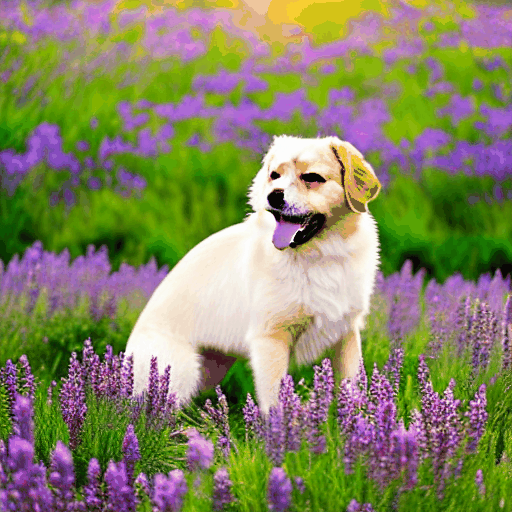

In [21]:
# generate imgs using interpolated embeddings
images = []
for prompt_embeds, negative_prompt_embeds in tqdm(
    zip(interpolated_prompt_embeds, interpolated_negative_prompts_embeds),
    total=len(interpolated_prompt_embeds),
):
    images.append(
        pipe(
            height=height,
            width=width,
            num_images_per_prompt=1,
            prompt_embeds=prompt_embeds[None, ...],
            negative_prompt_embeds=negative_prompt_embeds[None, ...],
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latents,
        ).images
    )

display_images(images, save_path)

## Circular walk through the diffusion latent space for a single prompt

Let’s imagine that we have two noise components, which we’ll call x and y. We start by moving from 0 to 2π and at each step we add the cosine of x and the sine of y to the result. Using this approach, at the end of our movement we end up with the same noise values ​​that we started with. This means that vectors end up turning into themselves, ending our movement.

  0%|          | 0/30 [00:00<?, ?it/s]

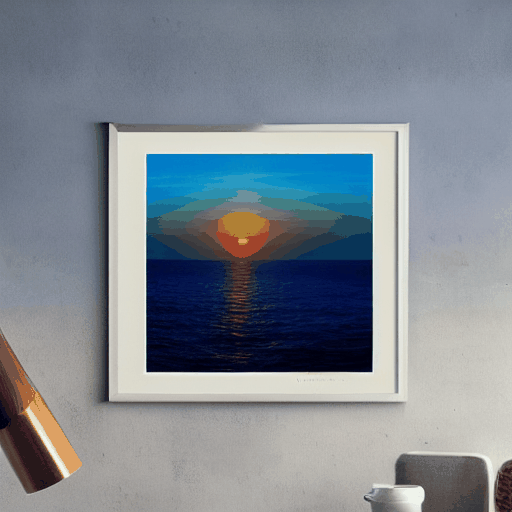

In [23]:
prompt = "Beautiful sea sunset, warm light, Aivazovsky style"
negative_prompt = "picture frames"

latents = torch.randn(
    (2, 1, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)

# calc of looped embeddings
walk_noise_x = latents[0].to(device)
walk_noise_y = latents[1].to(device)

# Walking on a trigonometric circle
walk_scale_x = torch.cos(torch.linspace(0, 2, num_interpolation_steps) * np.pi).to(device)
walk_scale_y = torch.sin(torch.linspace(0, 2, num_interpolation_steps) * np.pi).to(device)

# Applying interpolation to noise
noise_x = torch.tensordot(walk_scale_x, walk_noise_x, dims=0)
noise_y = torch.tensordot(walk_scale_y, walk_noise_y, dims=0)

circular_latents = noise_x + noise_y

# gen images using interpolated embs
images = []
for latent_vector in tqdm(circular_latents):
    images.append(
        pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latent_vector,
        ).images
    )

display_images(images, save_path)

Moving forward, you can explore various parameters such as guidance scale, seed, and number of interpolation steps to observe how they affect the generated images. Additionally, consider trying out different prompts and schedulers to further enhance your results. Another valuable step would be to implement linear interpolation (linspace) instead of spherical linear interpolation (slerp) and compare the results to gain deeper insights into the interpolation process.